**Background and Context**

* In recent times, the field of agriculture has been in urgent need of modernizing, since the amount of manual work people need to put in to check if plants are growing correctly is still highly extensive. Despite several advances in agricultural technology, people working in the agricultural industry still need to have the ability to sort and recognize different plants and weeds, which takes a lot of time and effort in the long term.

* The potential is ripe for this trillion-dollar industry to be greatly impacted by technological innovations that cut down on the requirement for manual labor, and this is where Artificial Intelligence can benefit the workers in this field, as the time and energy required to identify plant seedlings will be greatly shortened by the use of AI and Deep Learning. The ability to do so far more efficiently and even more effectively than experienced manual labor could lead to better crop yields, the freeing up of human involvement for higher-order agricultural decision making, and in the long term will result in more sustainable environmental practices in agriculture as well.

**Objective**

The Aarhus University Signal Processing group, in collaboration with the University of Southern Denmark, has provided the data containing images of unique plants belonging to 12 different species. As a data scientist, I am building a Convolutional Neural Network model which would classify the plant seedlings into their respective 12 categories.

The goal of the project is to create a classifier capable of determining a plant's species from an image.

**List of Plant species**

* Black-grass
* Charlock
* Cleavers
* Common Chickweed
* Common Wheat
* Fat Hen
* Loose Silky-bent
* Maize
* Scentless Mayweed
* Shepherds Purse
* Small-flowered Cranesbill
* Sugar beet

In [1]:
#Reading the training images from the path and labelling them into the given categories
import numpy as np
import pandas as pd
import math                                                                                      # Importing math module to perform mathematical operations

import matplotlib.pyplot as plt
import cv2 # this is an important module to get imported which may even cause issues while reading the data if not used
import seaborn as sns # for data visualization 
import tensorflow as tf
import keras
import os
from tensorflow.keras.models import Sequential #sequential api for sequential model 
from tensorflow.keras.layers import Dense, Dropout, Flatten #importing different layers 
from tensorflow.keras.layers import Conv2D, MaxPooling2D, BatchNormalization, Activation, Input, LeakyReLU,Activation
from tensorflow.keras import backend 
from tensorflow.keras.utils import to_categorical #to perform one-hot encoding 
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from tensorflow.keras.optimizers import RMSprop,Adam,SGD #optimiers for optimizing the model
from tensorflow.keras.callbacks import EarlyStopping  #regularization method to prevent the overfitting
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import losses, optimizers


import tensorflow as tf
import tensorflow.keras.layers as L
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from sklearn.model_selection import train_test_split

from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import img_to_array, load_img

In [2]:
from google.colab import drive # Mount google drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [3]:
os.chdir('/content/drive/MyDrive')
#!ls

In [4]:
images=np.load("images.npy") #Load images

In [5]:
images

array([[[[ 35,  52,  78],
         [ 36,  49,  76],
         [ 31,  45,  69],
         ...,
         [ 78,  95, 114],
         [ 76,  93, 110],
         [ 80,  95, 109]],

        [[ 33,  46,  68],
         [ 37,  50,  73],
         [ 48,  65,  83],
         ...,
         [ 81,  96, 113],
         [ 74,  89, 105],
         [ 83,  95, 109]],

        [[ 34,  50,  68],
         [ 35,  52,  72],
         [ 70,  85, 101],
         ...,
         [ 83,  97, 112],
         [ 79,  94, 108],
         [ 79,  94, 107]],

        ...,

        [[ 35,  50,  69],
         [ 42,  57,  73],
         [ 42,  57,  72],
         ...,
         [ 60,  76,  92],
         [ 67,  81,  97],
         [ 64,  77,  95]],

        [[ 36,  52,  67],
         [ 48,  63,  78],
         [ 41,  57,  73],
         ...,
         [ 44,  66,  83],
         [ 58,  76,  91],
         [ 57,  74,  90]],

        [[ 44,  58,  70],
         [ 43,  57,  73],
         [ 40,  55,  72],
         ...,
         [ 41,  70,  92],
        

In [6]:
images.shape

(4750, 128, 128, 3)

In [7]:
labels=pd.read_csv("Labels.csv") # Load the plant species as labels
labels

,Label
0,Small-flowered Cranesbill
1,Small-flowered Cranesbill
2,Small-flowered Cranesbill
3,Small-flowered Cranesbill
4,Small-flowered Cranesbill
...,...
4745,Loose Silky-bent
4746,Loose Silky-bent
4747,Loose Silky-bent
4748,Loose Silky-bent


In [8]:

label_dist = labels['Label'].value_counts()

def ditribution_plot(x,y,name):
    fig = go.Figure([
        go.Bar(x=x, y=y)
    ])

    fig.update_layout(title_text=name)
    fig.show()

In [9]:
label_dist.index

Index(['Loose Silky-bent', 'Common Chickweed', 'Scentless Mayweed',
       'Small-flowered Cranesbill', 'Fat Hen', 'Charlock', 'Sugar beet',
       'Cleavers', 'Black-grass', 'Shepherds Purse', 'Common wheat', 'Maize'],
      dtype='object')

In [10]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to show the density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

In [11]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n].sort_values(ascending=True),
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

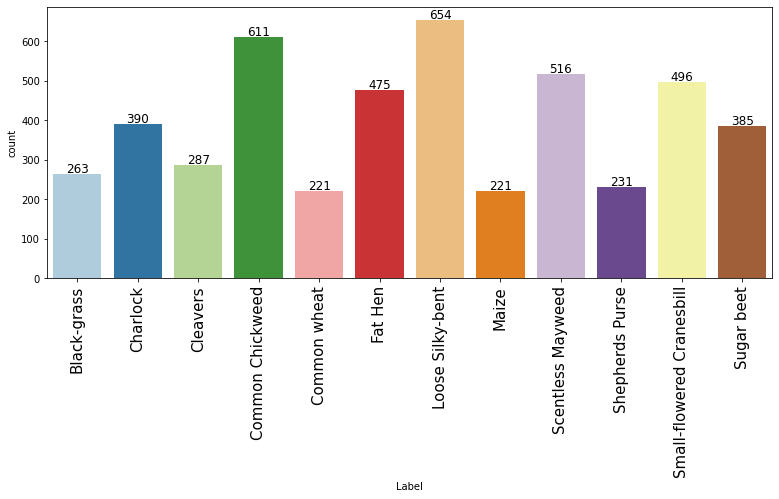

In [12]:
labeled_barplot(labels,"Label")

In [13]:
ditribution_plot(x=label_dist.index, y=label_dist.values, name='Label Distribution')

* Most of the plant species are Loose Silky-bent (14%),while the least is Maize (5%).
* The data is unbalanced. Later in this analysis class weights will be generated to balance the data and minimize the chance of overfitting or underfitting.

In [14]:
labels["Label"].value_counts(1)*100 # In percentage

Loose Silky-bent             13.768421
Common Chickweed             12.863158
Scentless Mayweed            10.863158
Small-flowered Cranesbill    10.442105
Fat Hen                      10.000000
Charlock                      8.210526
Sugar beet                    8.105263
Cleavers                      6.042105
Black-grass                   5.536842
Shepherds Purse               4.863158
Common wheat                  4.652632
Maize                         4.652632
Name: Label, dtype: float64

In [15]:
labels["Label"].value_counts(0)

Loose Silky-bent             654
Common Chickweed             611
Scentless Mayweed            516
Small-flowered Cranesbill    496
Fat Hen                      475
Charlock                     390
Sugar beet                   385
Cleavers                     287
Black-grass                  263
Shepherds Purse              231
Common wheat                 221
Maize                        221
Name: Label, dtype: int64

In [16]:
!pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [17]:
labels.value_counts()

Label                    
Loose Silky-bent             654
Common Chickweed             611
Scentless Mayweed            516
Small-flowered Cranesbill    496
Fat Hen                      475
Charlock                     390
Sugar beet                   385
Cleavers                     287
Black-grass                  263
Shepherds Purse              231
Common wheat                 221
Maize                        221
dtype: int64

In [18]:
labels.values.tolist()

[['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small-flowered Cranesbill'],
 ['Small

In [19]:
labels.shape

(4750, 1)

In [20]:
images.shape # View image shape

(4750, 128, 128, 3)

In [21]:
DATADIR = "/content/" 

In [22]:
images

array([[[[ 35,  52,  78],
         [ 36,  49,  76],
         [ 31,  45,  69],
         ...,
         [ 78,  95, 114],
         [ 76,  93, 110],
         [ 80,  95, 109]],

        [[ 33,  46,  68],
         [ 37,  50,  73],
         [ 48,  65,  83],
         ...,
         [ 81,  96, 113],
         [ 74,  89, 105],
         [ 83,  95, 109]],

        [[ 34,  50,  68],
         [ 35,  52,  72],
         [ 70,  85, 101],
         ...,
         [ 83,  97, 112],
         [ 79,  94, 108],
         [ 79,  94, 107]],

        ...,

        [[ 35,  50,  69],
         [ 42,  57,  73],
         [ 42,  57,  72],
         ...,
         [ 60,  76,  92],
         [ 67,  81,  97],
         [ 64,  77,  95]],

        [[ 36,  52,  67],
         [ 48,  63,  78],
         [ 41,  57,  73],
         ...,
         [ 44,  66,  83],
         [ 58,  76,  91],
         [ 57,  74,  90]],

        [[ 44,  58,  70],
         [ 43,  57,  73],
         [ 40,  55,  72],
         ...,
         [ 41,  70,  92],
        

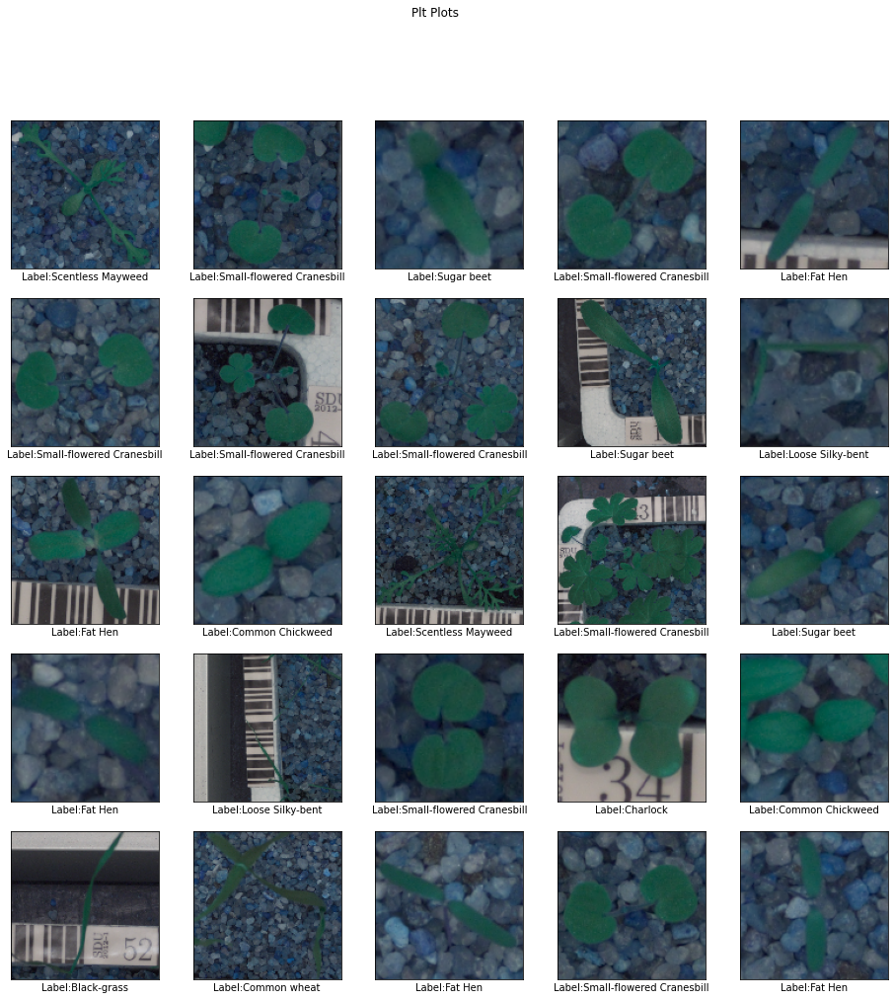

In [23]:
plt.figure(figsize=(16,16))
for j,i in enumerate(np.random.randint(0,4750,25)):

    plt.subplot(5,5,j+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i])
    plt.suptitle("Plt Plots")
    plt.xlabel(
        "Label:"+str(labels["Label"].iloc[i])
    )
plt.show()

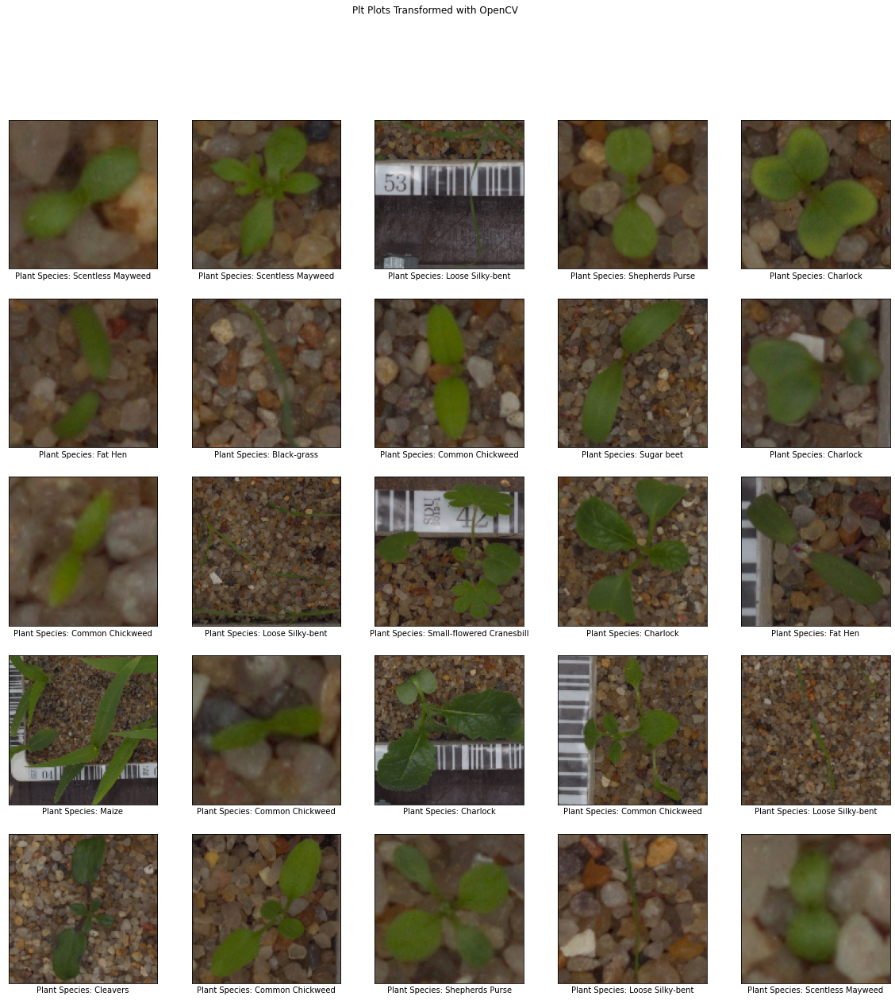

In [24]:
plt.figure(figsize=(20,20))
for j,i in enumerate(np.random.randint(0,4750,25)):

    plt.subplot(5,5,j+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.suptitle("Plt Plots Transformed with OpenCV")

    plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
    plt.xlabel(
        "Plant Species: "+str(labels["Label"].iloc[i])
    )
plt.show()


In [25]:
# Converting the images from BGR to RGB using cvtColor function of OpenCV
for i in range(len(images)):
  images[i] = cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB)

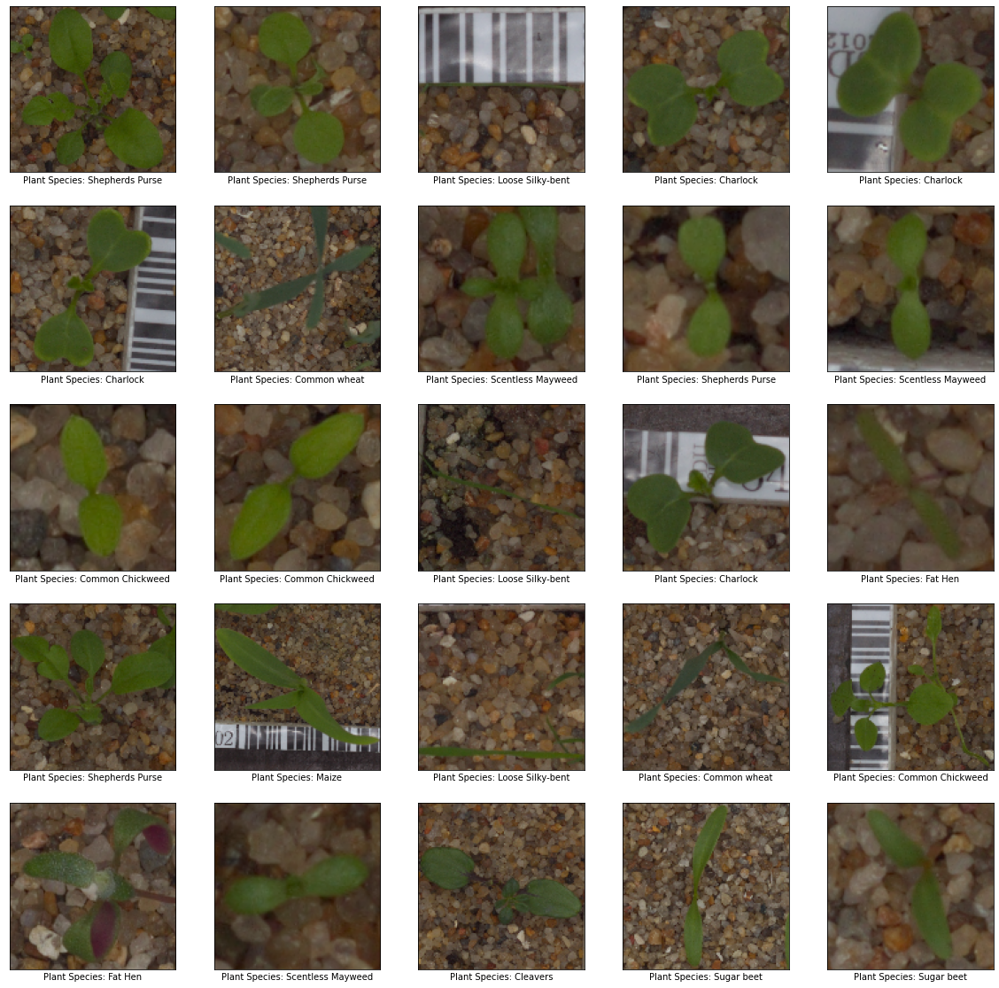

In [26]:
plt.figure(figsize=(20,20))
for j,i in enumerate(np.random.randint(0,4750,25)):

    plt.subplot(5,5,j+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i])
    plt.xlabel(
        "Plant Species: "+str(labels["Label"].iloc[i])
    )
plt.show()

**Using Normalised Pixel (0,1)**

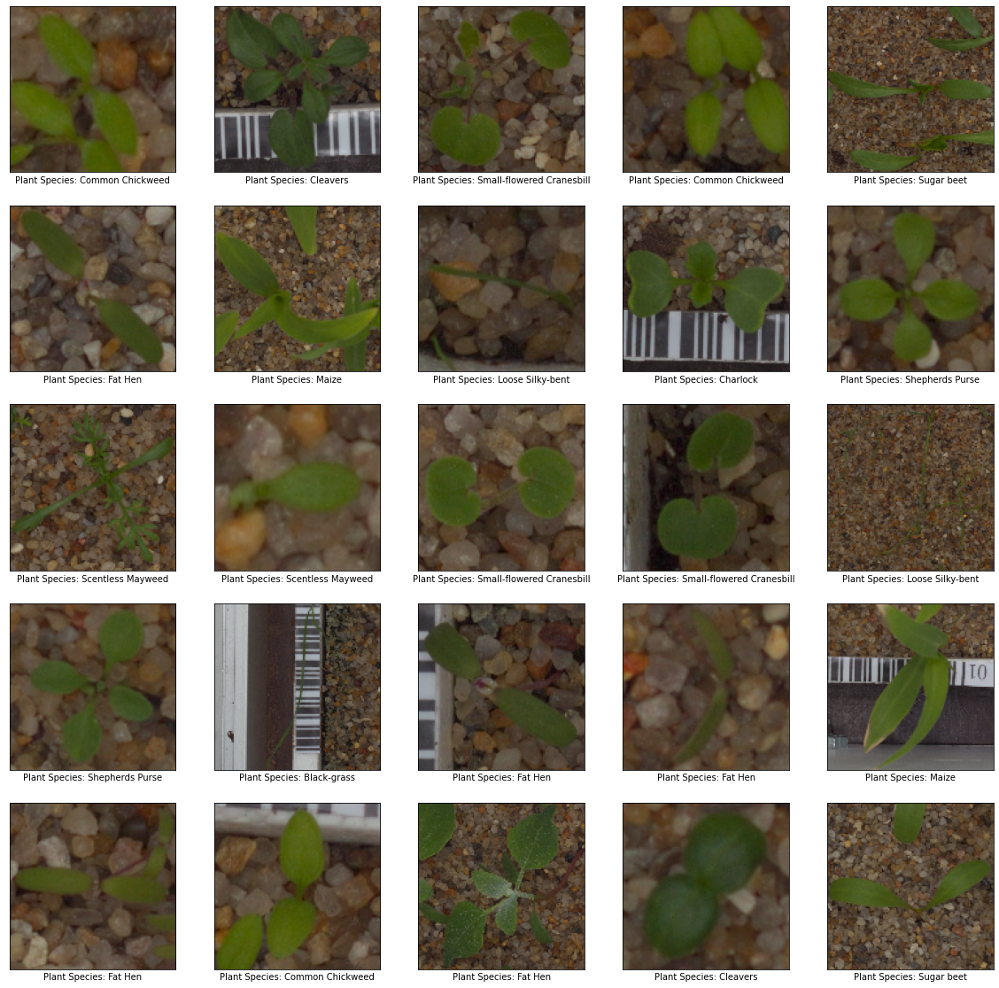

In [27]:
plt.figure(figsize=(20,20))
for j,i in enumerate(np.random.randint(0,4750,25)):

    plt.subplot(5,5,j+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i]/255.0)
    plt.xlabel(
        "Plant Species: "+str(labels["Label"].iloc[i])
    )
plt.show()

## Visualizing images using Gaussian Blur 

In [28]:
# Applying Gaussian Blur to denoise the images
images_gb=[]
for i in range(len(images)):
  # gb[i] = cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB)
  images_gb.append(cv2.GaussianBlur(images[i], ksize =(3,3),sigmaX =  0))


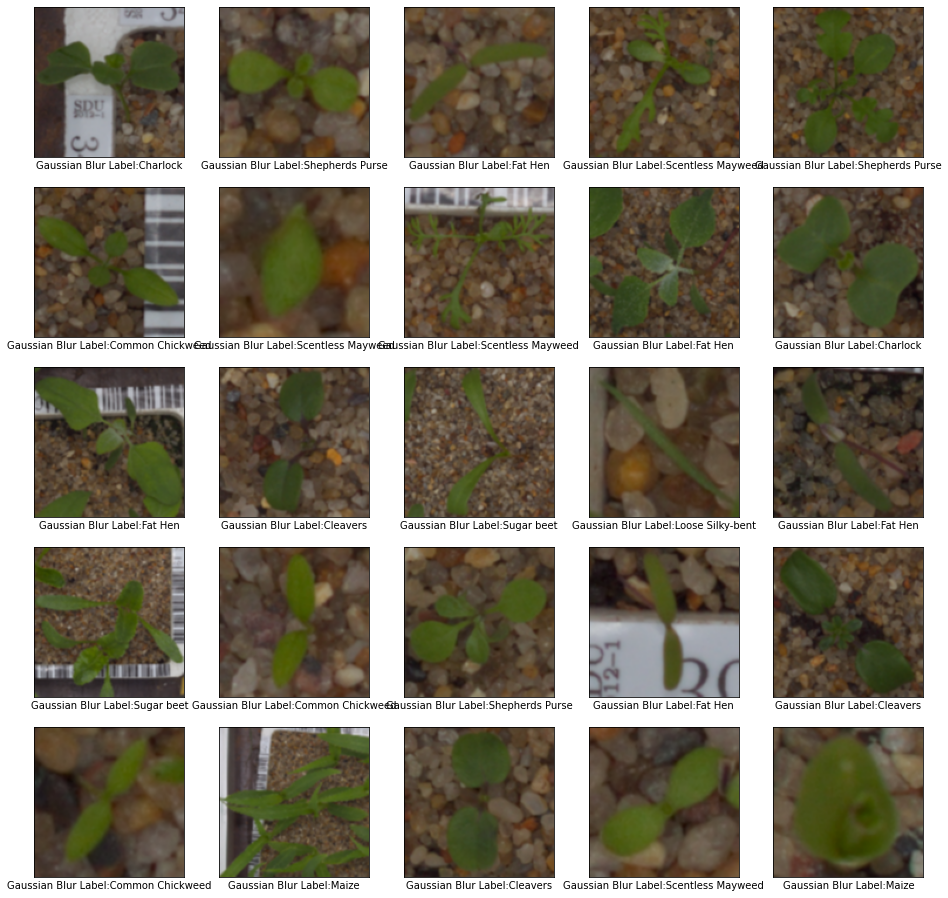

In [29]:
plt.figure(figsize=(16,16))
for j,i in enumerate(np.random.randint(0,4750,25)):

    plt.subplot(5,5,j+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images_gb[i])
    plt.xlabel(
        "Gaussian Blur Label:"+str(labels["Label"].iloc[i])
    )
plt.show()

Both normalized pixels and Gaussian Blur produced a similar effect.

In [30]:
y=labels["Label"]

In [31]:
y

0       Small-flowered Cranesbill
1       Small-flowered Cranesbill
2       Small-flowered Cranesbill
3       Small-flowered Cranesbill
4       Small-flowered Cranesbill
                  ...            
4745             Loose Silky-bent
4746             Loose Silky-bent
4747             Loose Silky-bent
4748             Loose Silky-bent
4749             Loose Silky-bent
Name: Label, Length: 4750, dtype: object

In [32]:
CATEGORIES=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen', 'Loose Silky-bent', 'Maize', 'Scentless Mayweed','Shepherds Purse', 'Small-flowered Cranesbill', 'Sugar beet']


In [33]:
images=np.array(images)

In [34]:
#img_array = cv2.imread(images)
#new_images = cv2.resize(img_array,(224,224))

In [35]:
X=images

In [36]:
from sklearn.model_selection import train_test_split

In [37]:
X_train, X_more, y_train, y_more = train_test_split(
    X, y, test_size=0.30, random_state=42, stratify=y
)

In [38]:
X_test, X_val, y_test, y_val = train_test_split(
    X_more, y_more, test_size=0.01, random_state=42,stratify=y_more
)

In [39]:
X_train=X_train/255.0
X_test=X_test/255.0
X_val=X_val/255.0

In [40]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_le=le.fit_transform(y_train)
y_test_le=le.transform(y_test)
y_val_le=le.transform(y_val)

In [41]:
from sklearn.preprocessing import LabelBinarizer
# Storing the LabelBinarizer function in lb variable
lb = LabelBinarizer() 
# Applying fit_transform on train target variable
y_train_e = lb.fit_transform(y_train)
# Applying only transform on test target variable
y_test_e = lb.transform(y_test)
y_val_e = lb.transform(y_val)

In [42]:
from sklearn.utils import class_weight


In [43]:
from sklearn.utils import class_weight # To balance an unbalanced dataset, in this case plant labels

labelList = labels.Label.unique()
class_weights = class_weight.compute_class_weight(class_weight = "balanced",
                                                  classes = np.array(labelList),
                                                  y = y_train.values.reshape(-1)
                                                  )
class_weights = dict(zip(np.array(range(len(labelList))), class_weights))
#print calculated class weights
class_weights


{0: 0.7985110470701249,
 1: 0.8345883534136547,
 2: 1.7103909465020577,
 3: 1.7876344086021505,
 4: 0.6473909657320872,
 5: 1.014957264957265,
 6: 1.378524046434494,
 7: 0.7675438596491229,
 8: 1.0300495662949194,
 9: 1.7876344086021505,
 10: 1.5058876811594204,
 11: 0.6049854439592431}

**Model 1 - Without Data Augmentation**

In [44]:
# Intializing a sequential model
model = Sequential()

# Adding first conv layer with 64 filters and kernel size 3x3 , padding 'same' provides the output size same as the input size
# Input_shape denotes input image dimension 
model.add(Conv2D(64, (3, 3), activation='relu', padding="same", input_shape=(128,128,3)))
model.add(Conv2D(64, (3, 3), activation='relu', padding="same"))

# Adding max pooling to reduce the size of output of first conv layer
model.add(MaxPooling2D((2, 2), padding = 'same'))

model.add(Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(MaxPooling2D((2, 2), padding = 'same'))
model.add(Conv2D(128, (3, 3), activation='relu', padding="same"))
model.add(MaxPooling2D((2, 2), padding = 'same'))

# flattening the output of the conv layer after max pooling to make it ready for creating dense connections
model.add(Flatten())

# Adding a fully connected dense layer with 64 neurons    
model.add(Dense(64, activation='relu'))

# Adding the output layer with 12 neurons and activation functions as softmax since this is a multi-class classification problem  
model.add(Dense(12, activation='softmax'))

# Using Adam Optimizer
opt = Adam(learning_rate=0.001)

# Compile model
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])


# Defining Early stopping
es = EarlyStopping(monitor='loss', mode='min', verbose=1, patience=5)
mc = ModelCheckpoint('best_model_imaging.h5', monitor='val_accuracy', mode='max', verbose=1, save_best_only=True)

# Generating the summary of the model
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 64)       0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 128)       1

In [45]:
# Fitting the model with 30 epochs and validation_split as 10%
history=model.fit(X_train, 
          y_train_e,  class_weight=class_weights,
          epochs=100, 
          batch_size=32,validation_split=0.10,callbacks=[es, mc])  

Epoch 1/100
94/94 [==============================] - ETA: 0s - loss: 2.6967 - accuracy: 0.2042
Epoch 1: val_accuracy improved from -inf to 0.35135, saving model to best_model_imaging.h5
94/94 [==============================] - 18s 54ms/step - loss: 2.6967 - accuracy: 0.2042 - val_loss: 2.1053 - val_accuracy: 0.3514
Epoch 2/100
93/94 [============================>.] - ETA: 0s - loss: 2.0806 - accuracy: 0.3871
Epoch 2: val_accuracy improved from 0.35135 to 0.43544, saving model to best_model_imaging.h5
94/94 [==============================] - 4s 38ms/step - loss: 2.0771 - accuracy: 0.3884 - val_loss: 1.6872 - val_accuracy: 0.4354
Epoch 3/100
93/94 [============================>.] - ETA: 0s - loss: 1.6242 - accuracy: 0.4896
Epoch 3: val_accuracy improved from 0.43544 to 0.46547, saving model to best_model_imaging.h5
94/94 [==============================] - 4s 38ms/step - loss: 1.6240 - accuracy: 0.4903 - val_loss: 1.6086 - val_accuracy: 0.4655
Epoch 4/100
93/94 [==========================

In [46]:
import plotly.express as px


In [47]:
fig = px.line(
    history.history, y=['accuracy', 'val_accuracy'],
    labels={'index': 'epoch', 'value': 'accuracy'}, 
    title='Training History')
fig.show()

In [48]:
model_1_train=model.evaluate(X_train,y_train_e)
model_1_train

104/104 [==============================] - 2s 15ms/step - loss: 0.2169 - accuracy: 0.9651


[0.21691390872001648, 0.9651128053665161]

In [49]:
model_1_test=model.evaluate(X_test,y_test_e)
model_1_test


45/45 [==============================] - 1s 15ms/step - loss: 1.9732 - accuracy: 0.7305


[1.9731645584106445, 0.7304964661598206]

In [50]:
pred_test_p=model.predict(X_test)
pred_test=np.argmax(pred_test_p, axis=1)
pred_test

array([ 8, 10,  6, ...,  8, 10, 10])

In [51]:
model_1_val=model.evaluate(X_val,y_val_e)
model_1_val

1/1 [==============================] - 0s 121ms/step - loss: 1.9566 - accuracy: 0.6000


[1.956565499305725, 0.6000000238418579]

In [52]:
pred_val=model.predict(X_val)
pred_val=np.argmax(pred_val, axis=1)
pred_val

array([ 6,  6,  1,  1, 10,  9,  8,  5, 11,  9,  6,  2, 11, 10,  3])

In [53]:
#Calculating the probability of the predicted class
pred_test_max_probas = np.max(pred_test_p, axis=1)

In [54]:
y_test.value_counts()

Loose Silky-bent             194
Common Chickweed             181
Scentless Mayweed            153
Small-flowered Cranesbill    148
Fat Hen                      142
Charlock                     116
Sugar beet                   115
Cleavers                      85
Black-grass                   78
Shepherds Purse               68
Maize                         65
Common wheat                  65
Name: Label, dtype: int64

In [55]:
#y_test_df=pd.DataFrame(y_test).reset_index(drop= True) 

In [56]:
#y_test_df=y_test_df.rename({'Loose Silky-bent':0,'Common Chickweed':1,'Scentless Mayweed':2,'Small-flowered Cranesbill':3,'Fat Hen':4,'Charlock':5,'Sugar beet':6,'Cleavers':7,'Black-grass':8,'Shepherds Purse':9,'Common wheat':10,'Maize':10})

In [57]:
y_test_le

array([ 8, 10,  6, ...,  8, 10, 10])

In [58]:
#Accuracy as per the classification report 
from sklearn import metrics
cr2=metrics.classification_report(y_test_le,pred_test)
print(cr2)

              precision    recall  f1-score   support

           0       0.42      0.27      0.33        78
           1       0.73      0.88      0.80       116
           2       0.75      0.76      0.76        85
           3       0.86      0.81      0.84       181
           4       0.61      0.68      0.64        65
           5       0.78      0.75      0.76       142
           6       0.71      0.78      0.75       194
           7       0.83      0.54      0.65        65
           8       0.63      0.73      0.67       153
           9       0.68      0.50      0.58        68
          10       0.82      0.89      0.86       148
          11       0.73      0.70      0.71       115

    accuracy                           0.73      1410
   macro avg       0.71      0.69      0.70      1410
weighted avg       0.73      0.73      0.72      1410



In [59]:
#Accuracy as per the classification report 
from sklearn import metrics
cr3=metrics.classification_report(y_val_le,pred_val)
print(cr3)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       0.50      1.00      0.67         1
           2       0.00      0.00      0.00         1
           3       1.00      0.50      0.67         2
           4       0.00      0.00      0.00         1
           5       1.00      1.00      1.00         1
           6       0.67      1.00      0.80         2
           7       0.00      0.00      0.00         1
           8       1.00      0.50      0.67         2
           9       0.50      1.00      0.67         1
          10       0.50      1.00      0.67         1
          11       0.50      1.00      0.67         1

    accuracy                           0.60        15
   macro avg       0.47      0.58      0.48        15
weighted avg       0.56      0.60      0.53        15



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [60]:
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

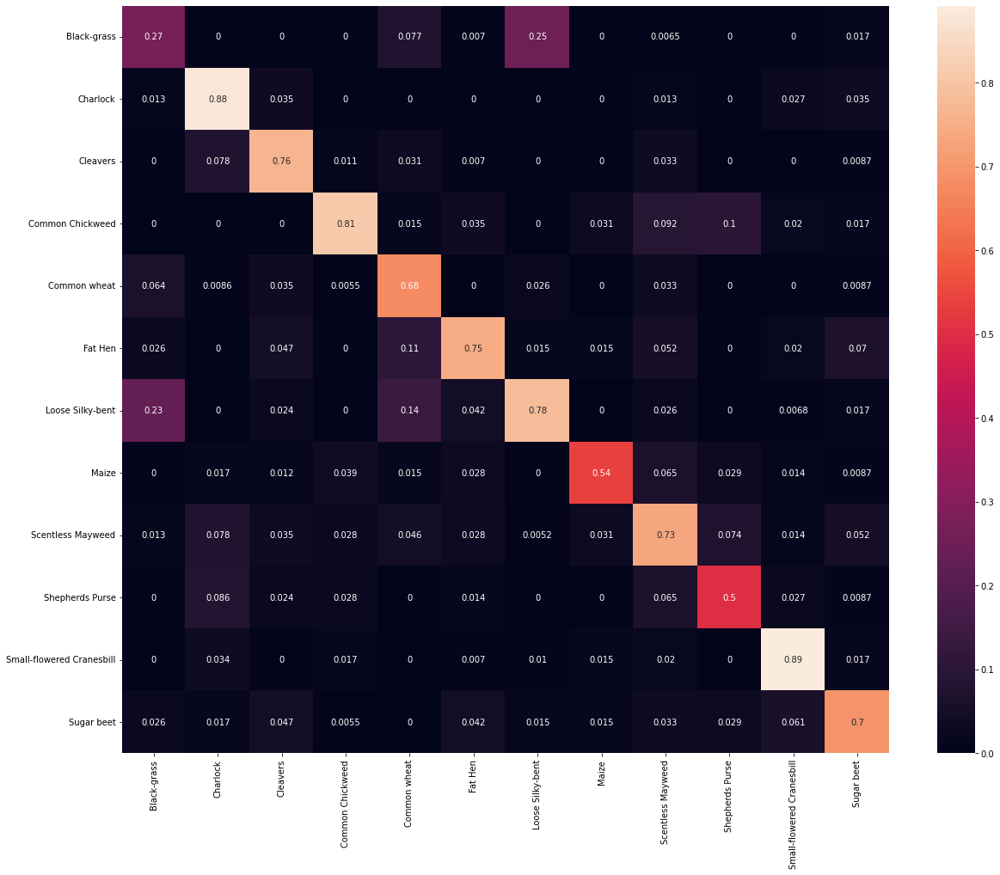

In [61]:
cf_matrix = confusion_matrix(y_test_le, pred_test)
CATEGORIES=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen', 'Loose Silky-bent', 'Maize', 'Scentless Mayweed','Shepherds Purse', 'Small-flowered Cranesbill', 'Sugar beet']

#CATEGORIES=y_test.unique()
# Confusion matrix normalized per category true value
cf_matrix_n1 = cf_matrix/np.sum(cf_matrix, axis=1)
plt.figure(figsize=(20,16))
sns.heatmap(cf_matrix_n1, xticklabels=CATEGORIES, yticklabels=CATEGORIES, annot=True)

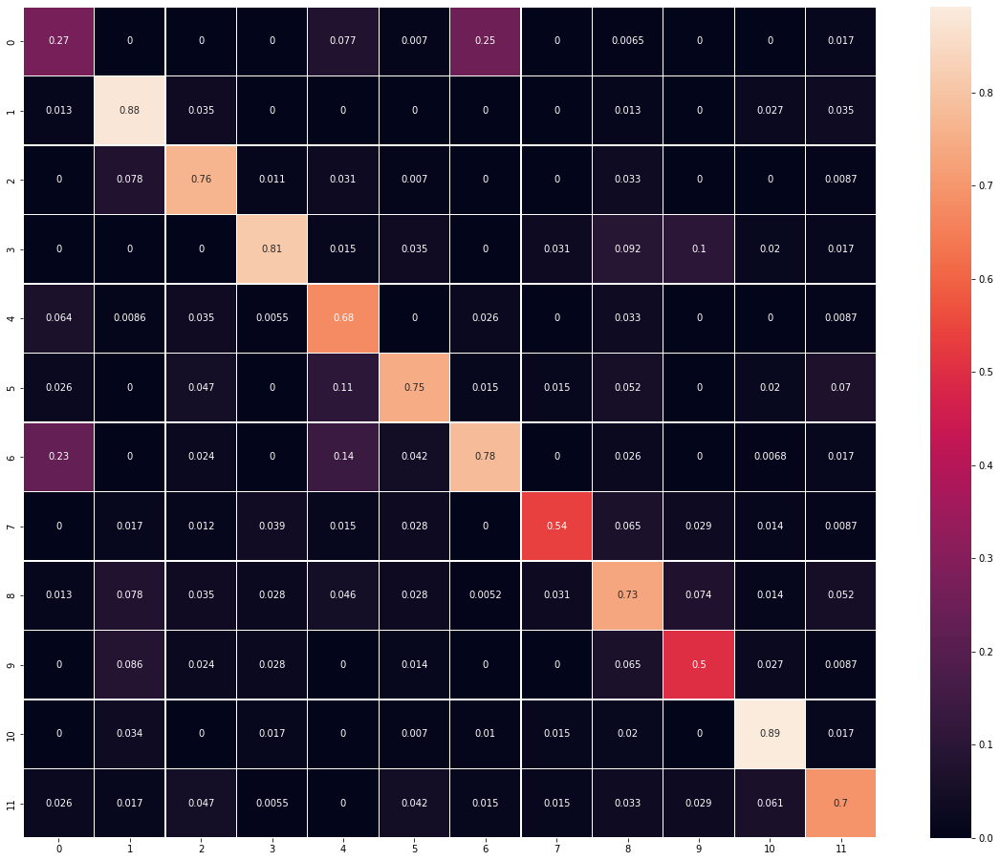

In [62]:
# Obtaining the categorical values from y_test_encoded and y_pred
#y_pred_arg=np.argmax(pred_test,axis=1)
y_pred_arg=pred_test
y_test_arg=np.argmax(y_test_e,axis=1)

#y_test_arg=y_test_le
# Plotting the Confusion Matrix using confusion matrix() function which is also predefined tensorflow module
confusion_matrix = tf.math.confusion_matrix(y_test_arg,y_pred_arg)
cf_matrix_n1_1 = confusion_matrix/np.sum(confusion_matrix, axis=1)

f, ax = plt.subplots(figsize=(20,16))
sns.heatmap(
    cf_matrix_n1_1,
    annot=True,
    linewidths=.4,
    #fmt="d",
    #square=True,
    #ax=ax
)
plt.show()


This confirms that the integer labels match the plant categories/species. We have a higher accuracy for Charlock and Sun-flowered Cranesbill, and the least for Black grass.

## Visualise predictions from Model 1

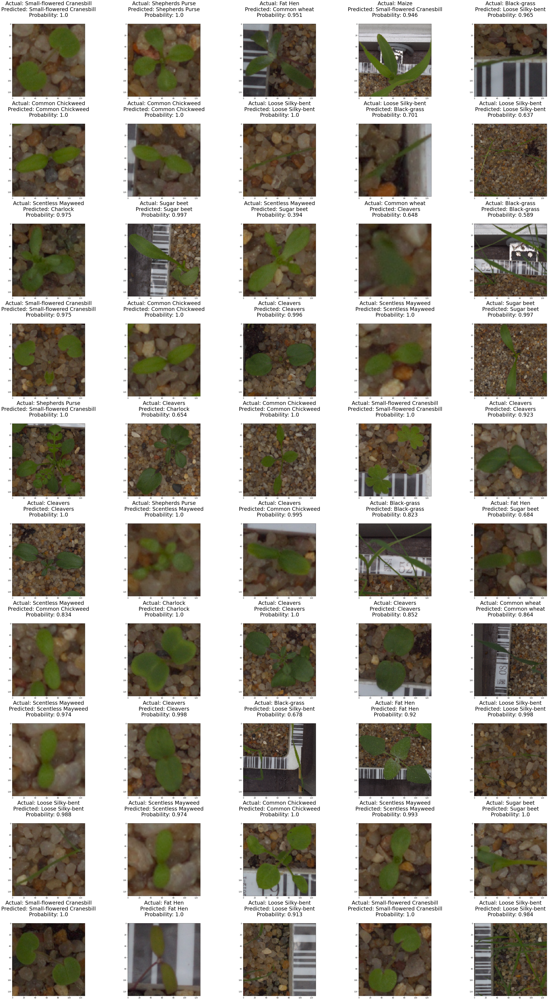

In [63]:
rows = 10
cols = 5
fig = plt.figure(figsize=(50, 80))
for i in range(cols):
    for j in range(rows):
        random_index = np.random.randint(0, len(y_test))
        ax = fig.add_subplot(rows, cols, i * rows + j + 1)
        ax.imshow(X_test[random_index, :])
        pred_label = CATEGORIES[pred_test[random_index]]
        #pred_proba = y_pred_test_max_probas[random_index]
        true_label = CATEGORIES[y_test_le[random_index]]
        pred_proba =pred_test_max_probas[random_index]
        ax.set_title("Actual: {}\nPredicted: {}\nProbability: {:.3}\n".format(
               true_label, pred_label, pred_proba),fontsize = 30)
        
        plt.tight_layout(pad=1)
plt.show()

# Data Augmentation Method

In [64]:
datagen = ImageDataGenerator(
    rotation_range=30,
    fill_mode='nearest'
    )

In [65]:
datagen.fit(X_train)

In [66]:
# Let's maintain same architecture as Model 1, and only perform image data augmentation
# Intializing a sequential model
model_2 = Sequential()

# Adding first conv layer with 64 filters and kernel size 3x3 , padding 'same' provides the output size same as the input size
# Input_shape denotes input image dimension of MNIST images
model_2.add(Conv2D(64, (3, 3), activation='relu', padding="same", input_shape=(128,128,3)))
model_2.add(Conv2D(64, (3, 3), activation='relu', padding="same"))

# Adding max pooling to reduce the size of output of first conv layer
model_2.add(MaxPooling2D((2, 2), padding = 'same'))

model_2.add(Conv2D(128, (3, 3), activation='relu', padding="same"))
model_2.add(MaxPooling2D((2, 2), padding = 'same'))
model_2.add(Conv2D(128, (3, 3), activation='relu', padding="same"))
model_2.add(MaxPooling2D((2, 2), padding = 'same'))

# flattening the output of the conv layer after max pooling to make it ready for creating dense connections
model_2.add(Flatten())

# Adding a fully connected dense layer with 64 neurons    
model_2.add(Dense(64, activation='relu'))

# Adding the output layer with 12 neurons and activation functions as softmax since this is a multi-class classification problem  
model_2.add(Dense(12, activation='softmax'))

# Using Adam Optimizer
opt = Adam(learning_rate=0.001)

# Compile model
model_2.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])


# Defining Early stopping
es = EarlyStopping(monitor='loss', mode='min', verbose=1, patience=5)
mc = ModelCheckpoint('best_model_imaging.h5', monitor='val_accuracy', mode='max', verbose=1, save_best_only=True)

# Generating the summary of the model
model_2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 128, 128, 64)      1792      
                                                                 
 conv2d_5 (Conv2D)           (None, 128, 128, 64)      36928     
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 64, 64, 64)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 32, 32, 128)      0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 32, 32, 128)      

In [67]:
batch_size=32
history_2 = model_2.fit(datagen.flow(X_train,y_train_e,
                                       batch_size=batch_size, 
                                       seed=42,
                                       shuffle=False),class_weight=class_weights,
                    epochs=100,
                    steps_per_epoch=X_train.shape[0] // batch_size,
                    validation_data=(X_val,y_val_e),verbose=1,callbacks=[es,mc])

Epoch 1/100
103/103 [==============================] - ETA: 0s - loss: 2.4723 - accuracy: 0.2624
Epoch 1: val_accuracy improved from -inf to 0.40000, saving model to best_model_imaging.h5
103/103 [==============================] - 14s 124ms/step - loss: 2.4723 - accuracy: 0.2624 - val_loss: 2.0844 - val_accuracy: 0.4000
Epoch 2/100
103/103 [==============================] - ETA: 0s - loss: 1.8350 - accuracy: 0.4109
Epoch 2: val_accuracy did not improve from 0.40000
103/103 [==============================] - 12s 116ms/step - loss: 1.8350 - accuracy: 0.4109 - val_loss: 1.7299 - val_accuracy: 0.4000
Epoch 3/100
103/103 [==============================] - ETA: 0s - loss: 1.6857 - accuracy: 0.4507
Epoch 3: val_accuracy did not improve from 0.40000
103/103 [==============================] - 12s 117ms/step - loss: 1.6857 - accuracy: 0.4507 - val_loss: 1.4153 - val_accuracy: 0.4000
Epoch 4/100
103/103 [==============================] - ETA: 0s - loss: 1.3862 - accuracy: 0.5439
Epoch 4: val_accu

In [68]:
fig = px.line(
    history_2.history, y=['accuracy', 'val_accuracy'],
    labels={'index': 'epoch', 'value': 'accuracy'}, 
    title='Training history for augmented images')
fig.show()

In [69]:
model_2_train=model_2.evaluate(X_train,y_train_e)
model_2_train

104/104 [==============================] - 2s 14ms/step - loss: 0.0374 - accuracy: 0.9865


[0.037377096712589264, 0.9864661693572998]

In [70]:
model_2_test=model_2.evaluate(X_test,y_test_e)
model_2_test

45/45 [==============================] - 1s 14ms/step - loss: 0.7651 - accuracy: 0.8489


[0.7651323080062866, 0.848936140537262]

In [71]:
pred_test_p_2=model_2.predict(X_test)
pred_test_2=np.argmax(pred_test_p_2, axis=1)
pred_test_2

array([ 8, 10,  6, ...,  8, 10, 10])

In [72]:
model_2_val=model_2.evaluate(X_val,y_val_e)
model_2_val

1/1 [==============================] - 0s 31ms/step - loss: 0.4195 - accuracy: 0.8000


[0.41946759819984436, 0.800000011920929]

In [73]:
pred_val_2=model_2.predict(X_val)
pred_val_2=np.argmax(pred_val_2, axis=1)
pred_val_2

array([ 0,  6,  2,  1,  7,  9,  8,  5,  3,  8,  6,  5, 11, 10,  3])

In [74]:
#Calculating the probability of the predicted class
pred_test_max_probas_2 = np.max(pred_test_p_2, axis=1)

In [75]:
#Accuracy as per the classification report 
from sklearn import metrics
cr2_2=metrics.classification_report(y_test_le,pred_test_2)
print(cr2_2)

              precision    recall  f1-score   support

           0       0.53      0.36      0.43        78
           1       0.87      0.97      0.92       116
           2       0.86      0.82      0.84        85
           3       0.89      0.96      0.92       181
           4       0.87      0.82      0.84        65
           5       0.95      0.85      0.90       142
           6       0.76      0.86      0.80       194
           7       0.79      0.88      0.83        65
           8       0.85      0.91      0.88       153
           9       0.86      0.65      0.74        68
          10       0.93      0.93      0.93       148
          11       0.89      0.83      0.86       115

    accuracy                           0.85      1410
   macro avg       0.84      0.82      0.82      1410
weighted avg       0.85      0.85      0.84      1410



In [76]:
#Accuracy as per the classification report 
from sklearn import metrics
cr3_2=metrics.classification_report(y_val_le,pred_val_2)
print(cr3_2)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         2
           4       0.00      0.00      0.00         1
           5       0.50      1.00      0.67         1
           6       0.50      0.50      0.50         2
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         2
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       1.00      1.00      1.00         1

    accuracy                           0.80        15
   macro avg       0.75      0.79      0.76        15
weighted avg       0.77      0.80      0.78        15



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [77]:
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

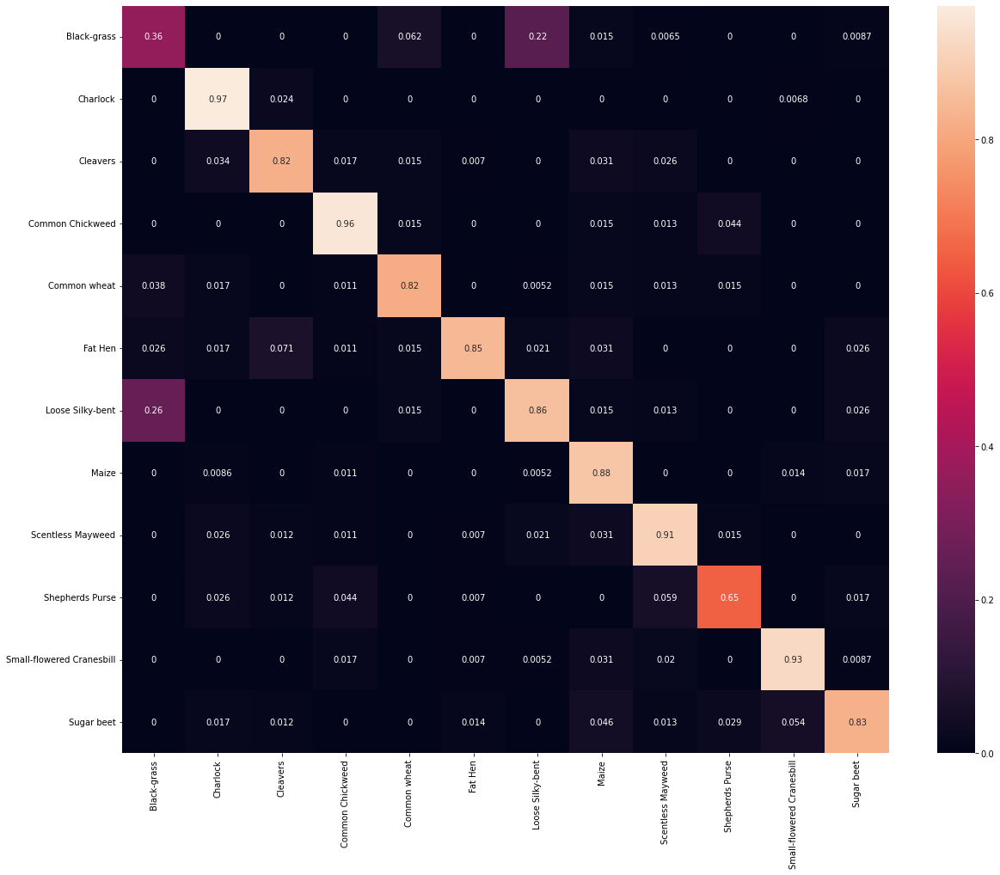

In [78]:

cf_matrix_2 = confusion_matrix(y_test_le, pred_test_2)
CATEGORIES=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen', 'Loose Silky-bent', 'Maize', 'Scentless Mayweed','Shepherds Purse', 'Small-flowered Cranesbill', 'Sugar beet']

#CATEGORIES=y_test.unique()
# Confusion matrix normalized per category true value
cf_matrix_n1_2 = cf_matrix_2/np.sum(cf_matrix_2, axis=1)
plt.figure(figsize=(20,16))
sns.heatmap(cf_matrix_n1_2, xticklabels=CATEGORIES, yticklabels=CATEGORIES, annot=True)

Charlock also has the highest accuracy and Black-grass the least in Model 2,

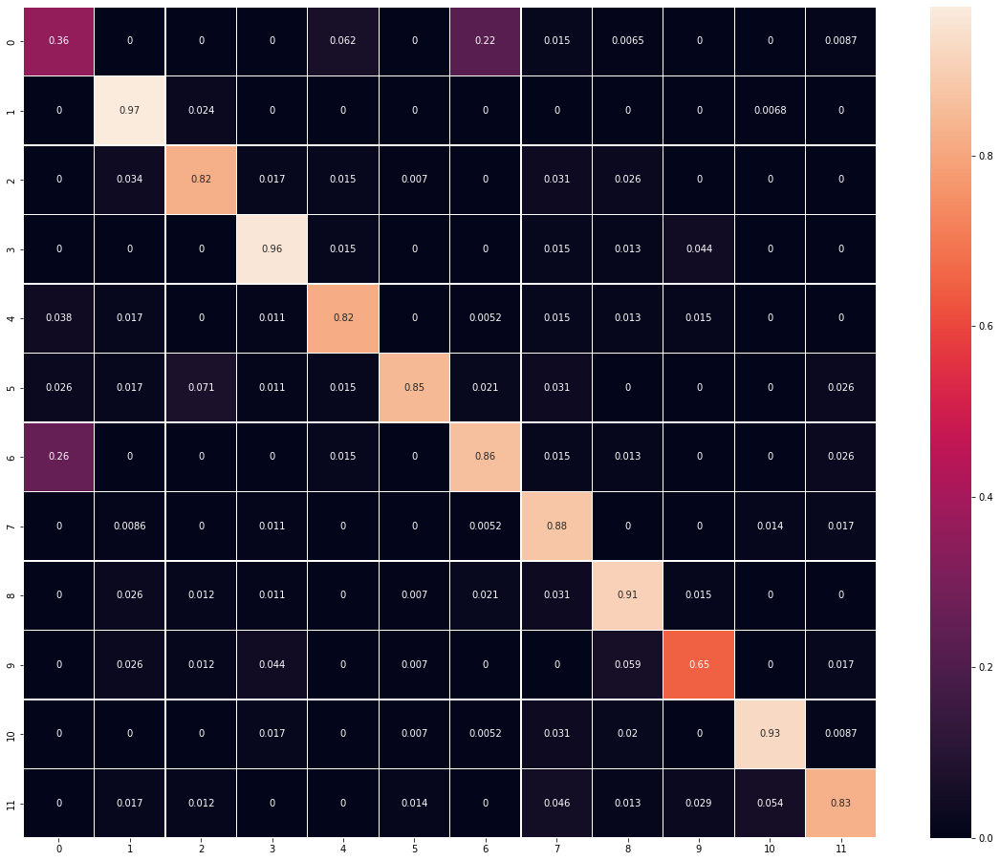

In [79]:
# Obtaining the categorical values from y_test_encoded and y_pred
y_pred_arg_2=pred_test_2  #Generated from here from previous line of code: pred_test_2=np.argmax(pred_test_2, axis=1)
y_test_arg_2=np.argmax(y_test_e,axis=1)

#y_test_arg_2=y_test_le

# Plotting the Confusion Matrix using confusion matrix() function which is also predefined tensorflow module
confusion_matrix_2_2 = tf.math.confusion_matrix(y_test_arg,y_pred_arg_2)
cf_matrix_n1_2 = confusion_matrix_2_2/np.sum(confusion_matrix_2_2, axis=1)

f, ax = plt.subplots(figsize=(20,16))
sns.heatmap(
    cf_matrix_n1_2,
    annot=True,
    linewidths=.4,
    
)
plt.show()

# Visualize predictions using Model 2

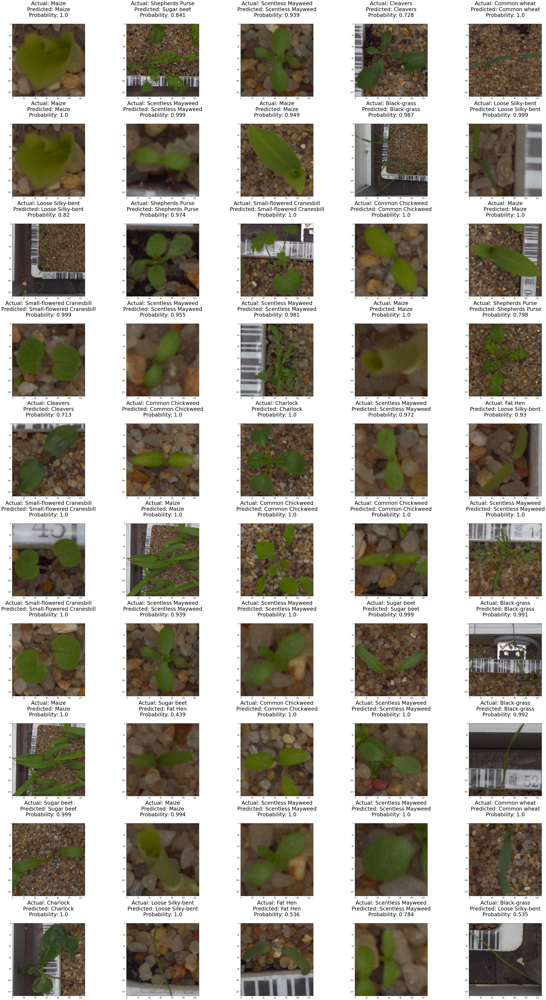

In [80]:
rows = 10
cols = 5
fig = plt.figure(figsize=(50, 80))
for i in range(cols):
    for j in range(rows):
        random_index = np.random.randint(0, len(y_test))
        ax = fig.add_subplot(rows, cols, i * rows + j + 1)
        ax.imshow(X_test[random_index, :])
        pred_label_2 = CATEGORIES[pred_test_2[random_index]]
        #pred_proba = y_pred_test_max_probas[random_index]
        true_label_2 = CATEGORIES[y_test_le[random_index]]
        pred_proba_2 =pred_test_max_probas_2[random_index]
        ax.set_title("Actual: {}\nPredicted: {}\nProbability: {:.3}\n".format(
               true_label_2, pred_label_2, pred_proba_2),fontsize = 30)
        
        plt.tight_layout(pad=1)
plt.show()

**Transfer Learning**

In [81]:
from tensorflow.keras.models import Model
from keras.applications.vgg16 import VGG16

vgg_model = VGG16(weights='imagenet', include_top = False, input_shape = (128,128,3))
vgg_model.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                              

In [82]:
# Making all the layers of the VGG model non-trainable. i.e. freezing them
for layer in vgg_model.layers:
    layer.trainable = False

In [83]:
new_model = Sequential()

# Adding the convolutional part of the VGG16 model from above
new_model.add(vgg_model)

# Flattening the output of the VGG16 model because it is from a convolutional layer
new_model.add(Flatten())

# Adding a fully connected dense layer with 64 neurons    
# Maintain the same fully connected dense layer as the other two models above and applying data augmentation
new_model.add(Dense(64, activation='relu'))

# Adding the output layer with 12 neurons and activation functions as softmax since this is a multi-class classification problem  
new_model.add(Dense(12, activation='softmax'))
opt=Adam()
# Compile model
new_model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Defining Early stopping
es = EarlyStopping(monitor='loss', mode='min', verbose=1, patience=5)
mc = ModelCheckpoint('best_model_imaging_transfer.h5', monitor='val_accuracy', mode='max', verbose=1, save_best_only=True)


# Generating the summary of the model
new_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten_2 (Flatten)         (None, 8192)              0         
                                                                 
 dense_4 (Dense)             (None, 64)                524352    
                                                                 
 dense_5 (Dense)             (None, 12)                780       
                                                                 
Total params: 15,239,820
Trainable params: 525,132
Non-trainable params: 14,714,688
_________________________________________________________________


In [84]:
batch_size=32
history_vgg16 = new_model.fit(datagen.flow(X_train,y_train_e,
                                       batch_size=batch_size, 
                                       seed=42,
                                       shuffle=False),class_weight=class_weights,
                    epochs=100,
                    steps_per_epoch=X_train.shape[0] // batch_size,
                    validation_data=(X_val,y_val_e),
                    verbose=1,callbacks=[es,mc])

Epoch 1/100
103/103 [==============================] - ETA: 0s - loss: 2.1532 - accuracy: 0.3565
Epoch 1: val_accuracy improved from -inf to 0.40000, saving model to best_model_imaging_transfer.h5
103/103 [==============================] - 14s 129ms/step - loss: 2.1532 - accuracy: 0.3565 - val_loss: 1.6256 - val_accuracy: 0.4000
Epoch 2/100
103/103 [==============================] - ETA: 0s - loss: 1.5357 - accuracy: 0.5311
Epoch 2: val_accuracy improved from 0.40000 to 0.53333, saving model to best_model_imaging_transfer.h5
103/103 [==============================] - 13s 123ms/step - loss: 1.5357 - accuracy: 0.5311 - val_loss: 1.3744 - val_accuracy: 0.5333
Epoch 3/100
103/103 [==============================] - ETA: 0s - loss: 1.2350 - accuracy: 0.6262
Epoch 3: val_accuracy improved from 0.53333 to 0.60000, saving model to best_model_imaging_transfer.h5
103/103 [==============================] - 13s 123ms/step - loss: 1.2350 - accuracy: 0.6262 - val_loss: 1.2385 - val_accuracy: 0.6000
E

In [85]:
import plotly.express as px


In [86]:
fig = px.line(
    history_vgg16.history, y=['accuracy', 'val_accuracy'],
    labels={'index': 'epoch', 'value': 'accuracy'}, 
    title='Training History')
fig.show()

In [87]:
model_3_train=new_model.evaluate(X_train,y_train_e)
model_3_train

104/104 [==============================] - 3s 29ms/step - loss: 0.0771 - accuracy: 0.9774


[0.07705596834421158, 0.9774436354637146]

In [88]:
model_3_test=new_model.evaluate(X_test,y_test_e)
model_3_test

45/45 [==============================] - 1s 31ms/step - loss: 0.9740 - accuracy: 0.7567


[0.9740337133407593, 0.7567375898361206]

In [89]:
pred_test_p_3=new_model.predict(X_test)
pred_test_3=np.argmax(pred_test_p_3, axis=1)
pred_test_3

array([ 8, 10,  6, ...,  8, 10, 10])

In [90]:
model_3_val=new_model.evaluate(X_val,y_val_e)
model_3_val

1/1 [==============================] - 0s 38ms/step - loss: 0.5910 - accuracy: 0.8000


[0.5910123586654663, 0.800000011920929]

In [91]:
pred_val_3=new_model.predict(X_val)
pred_val_3=np.argmax(pred_val_3, axis=1)
pred_val_3

array([ 6,  6,  2,  1,  7,  9,  8,  2,  3,  8,  6,  4,  5, 10,  3])

In [92]:
#Calculating the probability of the predicted class
pred_test_max_probas_3 = np.max(pred_test_p_3, axis=1)

In [93]:
#Accuracy as per the classification report 
from sklearn import metrics
cr2_3=metrics.classification_report(y_test_le,pred_test_3)
print(cr2_3)

              precision    recall  f1-score   support

           0       0.53      0.41      0.46        78
           1       0.81      0.86      0.84       116
           2       0.88      0.68      0.77        85
           3       0.78      0.88      0.83       181
           4       0.66      0.51      0.57        65
           5       0.71      0.75      0.73       142
           6       0.74      0.84      0.79       194
           7       0.75      0.80      0.78        65
           8       0.78      0.71      0.74       153
           9       0.60      0.62      0.61        68
          10       0.90      0.88      0.89       148
          11       0.74      0.71      0.73       115

    accuracy                           0.76      1410
   macro avg       0.74      0.72      0.73      1410
weighted avg       0.76      0.76      0.75      1410



In [94]:
#Accuracy as per the classification report 
from sklearn import metrics
cr3_3=metrics.classification_report(y_val_le,pred_val_3)
print(cr3_3)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         1
           1       1.00      1.00      1.00         1
           2       0.50      1.00      0.67         1
           3       1.00      1.00      1.00         2
           4       1.00      1.00      1.00         1
           5       0.00      0.00      0.00         1
           6       0.67      1.00      0.80         2
           7       1.00      1.00      1.00         1
           8       1.00      1.00      1.00         2
           9       1.00      1.00      1.00         1
          10       1.00      1.00      1.00         1
          11       0.00      0.00      0.00         1

    accuracy                           0.80        15
   macro avg       0.68      0.75      0.71        15
weighted avg       0.72      0.80      0.75        15



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [95]:
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix

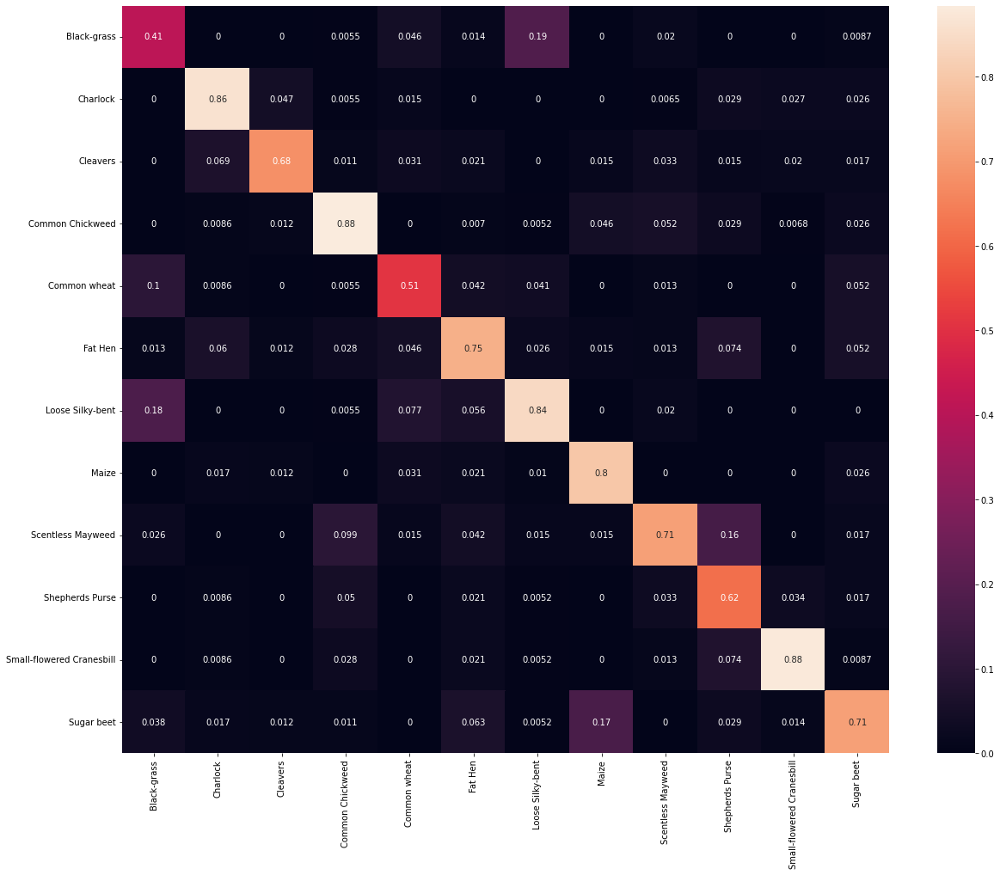

In [96]:
cf_matrix_3 = confusion_matrix(y_test_le, pred_test_3)
CATEGORIES=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen', 'Loose Silky-bent', 'Maize', 'Scentless Mayweed','Shepherds Purse', 'Small-flowered Cranesbill', 'Sugar beet']

#CATEGORIES=y_test.unique()
# Confusion matrix normalized per category true value
cf_matrix_n1_3 = cf_matrix_3/np.sum(cf_matrix_3, axis=1)
plt.figure(figsize=(20,16))
sns.heatmap(cf_matrix_n1_3, xticklabels=CATEGORIES, yticklabels=CATEGORIES, annot=True)

Charlock, Common Chickweed and Small-flowered Cranesbill have higher accuracy and Black-grass has the least accuracy score.

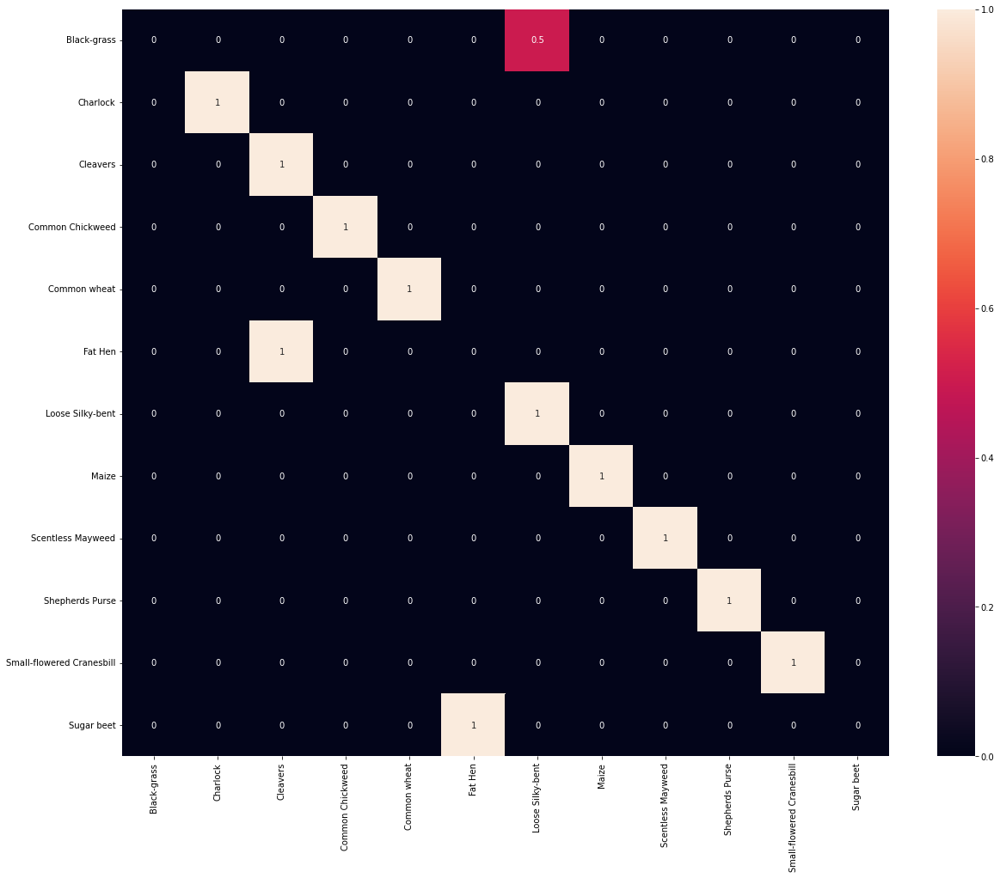

In [97]:
cf_matrix_val_3 = confusion_matrix(y_val_le, pred_val_3)
CATEGORIES=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen', 'Loose Silky-bent', 'Maize', 'Scentless Mayweed','Shepherds Purse', 'Small-flowered Cranesbill', 'Sugar beet']
# Confusion matrix normalized per category true value
#CATEGORIES=y_val.unique()

cf_matrix_n1_val_3 = cf_matrix_val_3/np.sum(cf_matrix_val_3, axis=1)
plt.figure(figsize=(20,16))
sns.heatmap(cf_matrix_n1_val_3, xticklabels=CATEGORIES, yticklabels=CATEGORIES, annot=True)

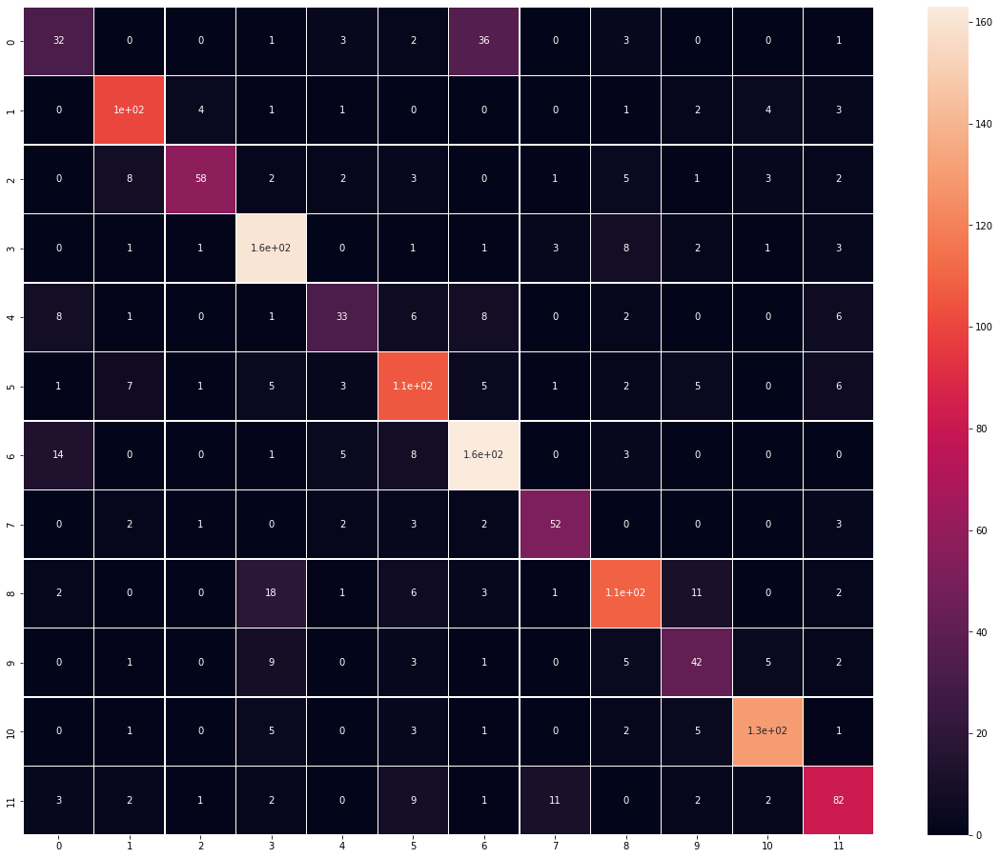

In [98]:
# Obtaining the categorical values from y_test_encoded and y_pred
y_pred_arg_3=pred_test_3
y_test_arg=np.argmax(y_test_e,axis=1)

# Plotting the Confusion Matrix using confusion matrix() function which is also predefined tensorflow module
confusion_matrix_3 = tf.math.confusion_matrix(y_test_arg,y_pred_arg_3)
f, ax = plt.subplots(figsize=(20, 16))
sns.heatmap(
    confusion_matrix_3,
    annot=True,
    linewidths=.4,
    
)
plt.show()

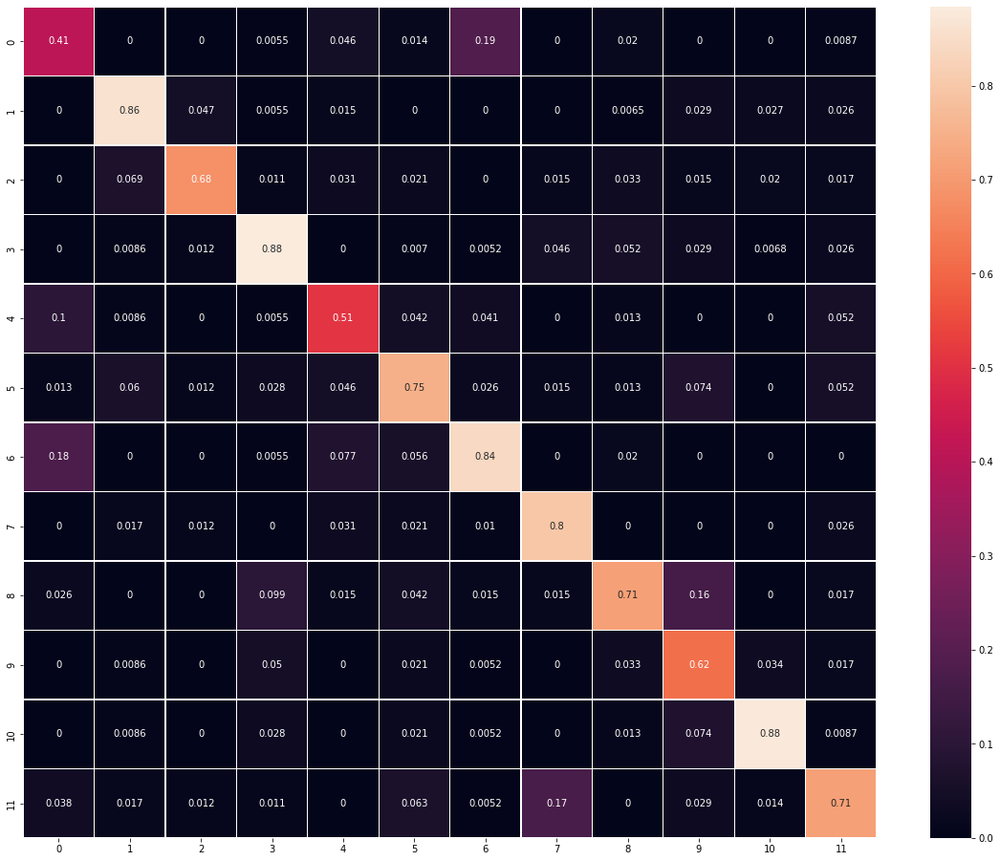

In [99]:
# Obtaining the categorical values from y_test_encoded and y_pred
#y_pred_arg=np.argmax(pred_test,axis=1)
y_pred_arg_3=pred_test_3
y_test_arg=np.argmax(y_test_e,axis=1)

#y_test_arg=y_test_le
# Plotting the Confusion Matrix using confusion matrix() function which is also predefined tensorflow module
confusion_matrix_3 = tf.math.confusion_matrix(y_test_arg,y_pred_arg_3)
cf_matrix_n1_3 = confusion_matrix_3/np.sum(confusion_matrix_3, axis=1)

f, ax = plt.subplots(figsize=(20,16))
sns.heatmap(
    cf_matrix_n1_3,
    annot=True,
    linewidths=.4,
    #fmt="d",
    #square=True,
    #ax=ax
)
plt.show()


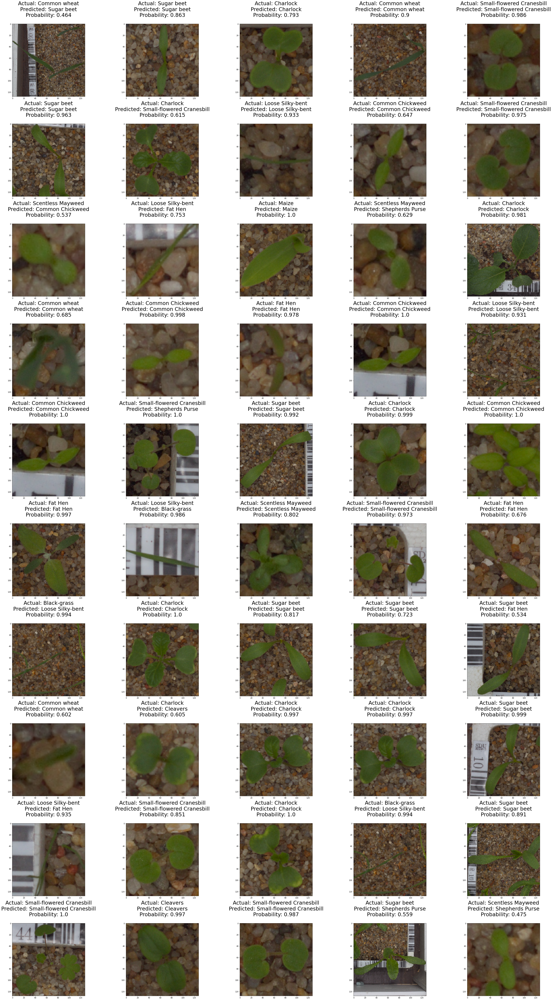

In [100]:
rows = 10
cols = 5
fig = plt.figure(figsize=(50, 80))
for i in range(cols):
    for j in range(rows):
        random_index = np.random.randint(0, len(y_test))
        ax = fig.add_subplot(rows, cols, i * rows + j + 1)
        ax.imshow(X_test[random_index, :])
        pred_label_3 = CATEGORIES[pred_test_3[random_index]]
        #pred_proba = y_pred_test_max_probas[random_index]
        true_label_3 = CATEGORIES[y_test_le[random_index]]
        pred_proba_3 =pred_test_max_probas_3[random_index]
        ax.set_title("Actual: {}\nPredicted: {}\nProbability: {:.3}\n".format(
               true_label_3, pred_label_3, pred_proba_3),fontsize = 30)
        
        plt.tight_layout(pad=1)
plt.show()

In [101]:
Cr_A_1=metrics.classification_report(y_test_le,pred_test)
Cr_A_2=metrics.classification_report(y_test_le,pred_test_2)
Cr_A_3=metrics.classification_report(y_test_le,pred_test_3)

In [102]:
pd.DataFrame({'Models':['CNN Model without Data Augmentation','CNN Model with Data Augmentation','Transfer Learning Model'],'Train Accuracy':[model_1_train[1],model_2_train[1],model_3_train[1]],'Validation Accuracy':[model_1_val[1],model_2_val[1],model_3_val[1]],'Test Accuracy':[model_1_test[1],model_2_test[1],model_3_test[1]]})

,Models,Train Accuracy,Validation Accuracy,Test Accuracy
0,CNN Model without Data Augmentation,0.965113,0.6,0.730496
1,CNN Model with Data Augmentation,0.986466,0.8,0.848936
2,Transfer Learning Model,0.977444,0.8,0.756738


The models appear overfitting as train accuracy is higher than validation and test accuracy. However, CNN Model with Data Augmentation has the best test accuracy (about 85%), followed by Transfer Learning with Data Augmentation (about 76%), and the least is the CNN Model without Data Augmentation (about 73%).

In [103]:
print("CNN Model without Data Augmentation:\n\n",Cr_A_1)

CNN Model without Data Augmentation:

               precision    recall  f1-score   support

           0       0.42      0.27      0.33        78
           1       0.73      0.88      0.80       116
           2       0.75      0.76      0.76        85
           3       0.86      0.81      0.84       181
           4       0.61      0.68      0.64        65
           5       0.78      0.75      0.76       142
           6       0.71      0.78      0.75       194
           7       0.83      0.54      0.65        65
           8       0.63      0.73      0.67       153
           9       0.68      0.50      0.58        68
          10       0.82      0.89      0.86       148
          11       0.73      0.70      0.71       115

    accuracy                           0.73      1410
   macro avg       0.71      0.69      0.70      1410
weighted avg       0.73      0.73      0.72      1410



Model 1 without data augmentation has a precision score of 73%, recall score of 73%, F1 score of 72%, and accuracy of 73%.

In [104]:
print("CNN Model with Data Augmentation:\n\n",Cr_A_2)

CNN Model with Data Augmentation:

               precision    recall  f1-score   support

           0       0.53      0.36      0.43        78
           1       0.87      0.97      0.92       116
           2       0.86      0.82      0.84        85
           3       0.89      0.96      0.92       181
           4       0.87      0.82      0.84        65
           5       0.95      0.85      0.90       142
           6       0.76      0.86      0.80       194
           7       0.79      0.88      0.83        65
           8       0.85      0.91      0.88       153
           9       0.86      0.65      0.74        68
          10       0.93      0.93      0.93       148
          11       0.89      0.83      0.86       115

    accuracy                           0.85      1410
   macro avg       0.84      0.82      0.82      1410
weighted avg       0.85      0.85      0.84      1410



Model 2 with data augmentation has a precision score of 85%, recall score of 85%, F1 score of 84%, and accuracy of 85%.

In [105]:
print("Transfer Learning Model:\n\n",Cr_A_3)

Transfer Learning Model:

               precision    recall  f1-score   support

           0       0.53      0.41      0.46        78
           1       0.81      0.86      0.84       116
           2       0.88      0.68      0.77        85
           3       0.78      0.88      0.83       181
           4       0.66      0.51      0.57        65
           5       0.71      0.75      0.73       142
           6       0.74      0.84      0.79       194
           7       0.75      0.80      0.78        65
           8       0.78      0.71      0.74       153
           9       0.60      0.62      0.61        68
          10       0.90      0.88      0.89       148
          11       0.74      0.71      0.73       115

    accuracy                           0.76      1410
   macro avg       0.74      0.72      0.73      1410
weighted avg       0.76      0.76      0.75      1410



Model 3 with transfer learning has a precision score of 76%, recall score of 76%, F1 score of 75%, and accuracy of 76%.

**Conclusion**

* We can observe from the confusion matrix of all the models that our CNN Model with Data Augmentation was the best model because it predicted the majority of the classes better than the other models.

* The test accuracy of the CNN Model with Data Augmentation is 85%.

* Data Augmentation has helped in improving the CNN model.
* Simply employing the transfer learning model can even produce a better outcome than any ordinary CNN.

**Scope of Improvement**
* These models can be further improved by training with different filter sizes and different number of filters.
* These models can also be trained on different image_size i.e 64 x 64 rather than using the original 128.
* Data Augmentation can be performed more and dropout_rate can be changed to improve the model performance.
* Other Transfer Learning architectures can also be used to train the CNN model and these models can be used for classification.